# City of San Diego 311 Requests Analysis

# Request Mapping

In [54]:
import json, string

import folium
import requests
import geocoder
import pandas as pd
import pickle

from folium import Map, Marker, GeoJson, LayerControl, FeatureGroup
from folium.plugins import MarkerCluster
#from ediblepickle import checkpoint
hide_code_in_slideshow()

In [55]:
from exif import Image
import exifread
hide_code_in_slideshow()

In [56]:
get_it_done = pd.read_csv('get_it_done_2020_ALL.csv') #all 311 requests to date 1/1/2020 -> 12/5/2020
hide_code_in_slideshow()

/Users/msutherland/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3071: DtypeWarning: Columns (12) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [57]:
locations = get_it_done[['lat', 'lng']]
locationlist = locations.values.tolist()

#Removing latitudes and longitudes that are equal to zero with coordinates pointing to "Null Island"
get_it_done =get_it_done[get_it_done['lat'] !=0.0]
get_it_done =get_it_done[get_it_done['lng'] !=0.0]

#Drop NAs so mapping works
get_it_done=get_it_done.dropna(subset=['lng'])
get_it_done=get_it_done.dropna(subset=['lat'])

In [58]:
#Using geocoder to find the locations for the City of San Diego
location = 'San Diego'
loc = geocoder.osm(location)
loc.json
hide_code_in_slideshow()

In [59]:
#Using a 50 request sample so that the map loads more quickly.
rndtest = get_it_done.sample(n=500)

#Change this back to the entire get_it_done dataset when READY.
#Comment out the rndtest line above
#rndtest = get_it_done
hide_code_in_slideshow()

In [60]:
from folium.plugins import MarkerCluster
from folium import FeatureGroup, LayerControl, Map, Marker

latlng = [loc.lat, loc.lng]
sd_map = folium.Map(location=latlng,
              #No tiles specification just makes a standard color map like apple maps or google maps
              #tiles = "CartoDB dark_matter",
              #tiles = "stamenwatercolor",
              #tiles = "stamentoner",
              
              zoom_start=15)

mc = MarkerCluster()

fg0_1 = FeatureGroup(name='Less than 1 day old')
fg1_3= FeatureGroup(name='1-3 days old')
fg3_5= FeatureGroup(name='3-5 days old')
fg5_10= FeatureGroup(name='5-10 days old')
fg10_20= FeatureGroup(name='10-20 old')
fg20_= FeatureGroup(name='More than 20 days old')

#age0_10 = rndtest.loc[rndtest['case_age_days'] <=10]
#age10_= rndtest.loc[rndtest['case_age_days'] >10]


for row in rndtest.itertuples():
#    mc.add_child(folium.Marker(location=[row.lat, row.lng],
#                 popup=row.service_name))
    if row.case_age_days <=1:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="green"),
      popup= row.service_name).add_to(fg0_1)

    elif row.case_age_days >1 and row.case_age_days <=3:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="lightgreen"),
      popup= row.service_name).add_to(fg1_3)
    
    elif row.case_age_days >3 and row.case_age_days <=5:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="orange"),
      popup= row.service_name).add_to(fg3_5)
        
    elif row.case_age_days >5 and row.case_age_days <=10:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="lightred"),
       popup= row.service_name).add_to(fg5_10)
    
    elif row.case_age_days >10 and row.case_age_days <=20:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="red"),
       popup= row.service_name).add_to(fg10_20)
        
    else:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="darkred"),
       popup= row.service_name).add_to(fg20_)
        

fg0_1.add_to(sd_map)
fg1_3.add_to(sd_map)
fg3_5.add_to(sd_map)
fg5_10.add_to(sd_map)
fg10_20.add_to(sd_map)
fg20_.add_to(sd_map)
LayerControl().add_to(sd_map)

#Add children to map    
#sd_map.add_child(mc)
sd_map   

In [61]:
service_counts = get_it_done.groupby('service_name')['service_request_id'].count().sort_values(ascending=False).reset_index()
total_sr = service_counts['service_request_id'].sum()
service_counts['percent_total']= service_counts['service_request_id']/total_sr

#service_counts.head()
service_counts.loc[service_counts['percent_total'] >=.01].shape

(17, 3)

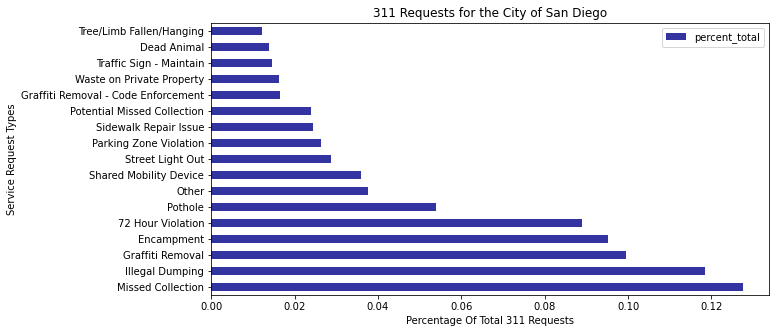

In [62]:
popular_services = service_counts.loc[service_counts['percent_total'] >=.01]
ax = popular_services.plot.barh(x='service_name', y='percent_total', rot=0, color='darkblue', alpha=.8, figsize=(10,5))
ax.set_title('311 Requests for the City of San Diego')
ax.set_xlabel('Percentage Of Total 311 Requests')
ax.set_ylabel('Service Request Types')
hide_code_in_slideshow()

# Request Prediction

In [63]:
#Import Libraries
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd
from urllib.request import urlopen # instead of urllib2 like in Python 2.7
import json
import numpy as np
import nltk
import string
import re
from sklearn import naive_bayes
from sklearn.naive_bayes import BernoulliNB
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn import metrics
from sklearn.metrics import accuracy_score
from nltk.corpus import stopwords
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import roc_auc_score
import numpy as np

#multi-class classification
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression

from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier
hide_code_in_slideshow()

In [64]:
#Loading Get It Done San Diego Data
gid_csv = pd.read_csv('get_it_done_2020_ALL.csv') #static data of all requests in 2020 to date (11/25/20)
hide_code_in_slideshow()


In [65]:
'''
Multinomial Naive Bayes    
tfidVectorizder
'''
#Filtering data with multiple criteria

gid_cln = gid_csv[(gid_csv['service_name'] == 'Missed Collection') | (gid_csv['service_name'] == 'Illegal Dumping') |
(gid_csv['service_name'] == 'Graffiti Removal') | (gid_csv['service_name'] == 'Encampment') | (gid_csv['service_name'] == '72 Hour Violation') |
(gid_csv['service_name'] == 'Pothole') | (gid_csv['service_name'] == 'Other') | (gid_csv['service_name'] == 'Shared Mobility Device') |
(gid_csv['service_name'] == 'Street Light Out') | (gid_csv['service_name'] == 'Parking Zone Violation') | (gid_csv['service_name'] == 'Sidewalk Repair Issue') |
(gid_csv['service_name'] == 'Traffic Sign - Maintain') | (gid_csv['service_name'] == 'Dead Animal') |
(gid_csv['service_name'] == 'Tree/Limb Fallen/Hanging')]

#Specify Relevant Columns to Keep
keep = ['service_name','public_description']
gid_clnR = gid_cln[keep]
len(gid_clnR)
#203702 requests
#Creating Training and Testing Datasets 70/30
mnb = gid_clnR
print(len(mnb))
#print(len(mnb2))
#58250
mnb_cln = mnb.dropna()
print(mnb_cln)
#print(mnb_cln2)
#[51350 rows x 2 columns]
mnb_cln.head()


stopset = set(stopwords.words('english'))
vectorizer = TfidfVectorizer(use_idf=True, lowercase=True, strip_accents='ascii', stop_words = stopset)

y = mnb_cln.service_name
x = vectorizer.fit_transform(mnb_cln.public_description)
  
print(y.shape)
print(x.shape)
#(51350,)
#(51350, 18314)
#There are 51350 observations and 18314 unique words

#set test train split
x_train, x_test, y_train, y_test = train_test_split(x, y, random_state = 36)

#train naive bayes classifier
clf = naive_bayes.MultinomialNB()
clf.fit(x_train, y_train)
hide_code_in_slideshow()

203702
                  service_name  \
0       Parking Zone Violation   
1       Parking Zone Violation   
5       Parking Zone Violation   
6              Illegal Dumping   
9             Graffiti Removal   
...                        ...   
265034  Parking Zone Violation   
265035       72 Hour Violation   
265036              Encampment   
265037                   Other   
265038       72 Hour Violation   

                                       public_description  
0       Large white converted schools bus. People livi...  
1       Tan Chevy RV, parked in dog beach parking lot ...  
5       SHOTS AND FIREWORKS IN BACK OF MY HOUSE AND IT...  
6       Illegal dumping of mattress and box spring in ...  
9                         PH gang graffiti on street sign  
...                                                   ...  
265034                  Car illegally parked in the alley  
265035  No plates at all, front or back. Car Is covere...  
265036  People living in white Ford suv, per

## Request user input to interact with the program
### The program returns the predicted request type based on the text input

In [66]:
#Creating a similar program but now it requests input from the user
request_input = input("What is your non-emergency issue / request? ")
#Test with user originated text
case311_array=np.array([request_input])
case311_vector = vectorizer.transform(case311_array)

print(clf.predict(case311_vector))

What is your non-emergency issue / request? I have a homeless guy at my house
['Encampment']


# Location Prediction From Image

In [67]:
#jpg
import os
import PIL.Image
from PIL import Image
import exifread
from PIL.ExifTags import TAGS
from exif import Image
from hachoir.parser import createParser
from hachoir.metadata import extractMetadata
hide_code_in_slideshow()

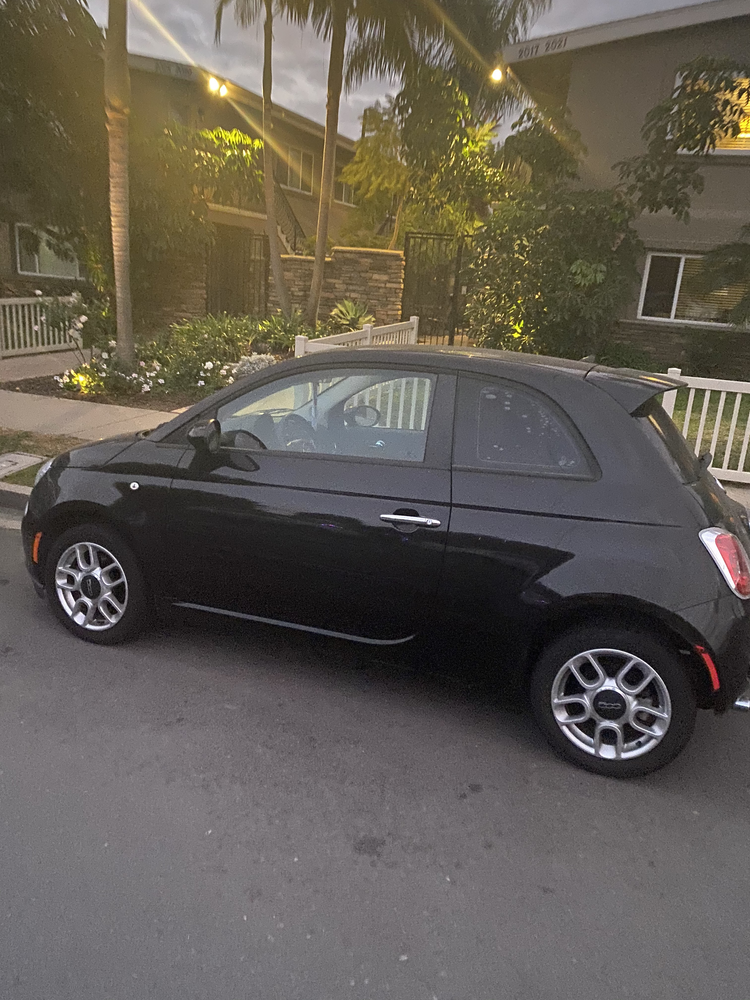

In [68]:
'''View Image'''
fiat = PIL.Image.open('fiat.jpg')
fiat

In [71]:
'''Parse Metadata'''
parser = createParser("fiat.jpg")
#parser = createParser("traffic_light.jpg")
#parser = createParser("t9.png")
metadata = extractMetadata(parser)

for line in metadata.exportPlaintext():
    print(line)
hide_code_in_slideshow()

[warn] [/exif/content/ifd[0]] [Autofix] Fix parser error: stop parser, found unparsed segment: start 1800, length 8
[warn] [/exif/content/exif[0]] [Autofix] Fix parser error: stop parser, found unparsed segment: start 5976, length 8, found unparsed segment: start 6040, length 8, found unparsed segment: start 6104, length 8
[warn] [/exif/content] [Autofix] Fix parser error: stop parser, found unparsed segment: start 17672, length 8
[warn] Skip IPTC key 63: 170132
[warn] Skip IPTC key 62: 20201212


Metadata:
- Image width: 3024 pixels
- Image height: 4032 pixels
- Image orientation: Horizontal (normal)
- Bits/pixel: 24
- Pixel format: YCbCr
- Creation date: 2020-12-12 17:01:32
- Latitude: 32.79673888888889
- Longitude: -117.2315
- Altitude: 8.3 meters
- Camera focal: 1.8
- Camera exposure: 1/14
- Camera brightness: -2.47
- City: %G
- Camera model: iPhone 11
- Camera manufacturer: Apple
- Compression: JPEG (Baseline)
- ISO speed rating: 500
- EXIF version: 0231
- Date-time original: 2020-12-12 17:01:32
- Date-time digitized: 2020-12-12 17:01:32
- Shutter speed: 3.77
- Aperture: 1.7
- Exposure bias: 0.0156
- Focal length: 4.25
- Flashpix version: 0100
- Focal length in 35mm film: 26
- Producer: 14.2
- Comment: JPEG quality: 93% (approximate)
- Format version: JFIF 1.01
- MIME type: image/jpeg
- Endianness: Big endian


In [72]:
car_map = folium.Map(location=latlng,
              #No tiles specification just makes a standard color map like apple maps or google maps
              tiles = "CartoDB dark_matter",
              #tiles = "stamenwatercolor",
              #tiles = "stamentoner",
              zoom_start=13)

feature_group = FeatureGroup(name='Fiat 500')

fiat_icon = folium.features.CustomIcon('fiat.jpg', icon_size=(50,50))
fiat_popup="<strong>Location:</strong><br>Fiat 500"
Marker(location=[32.79673888888889,-117.2315], icon=fiat_icon, tooltip="Fiat 500",
    popup=fiat_popup).add_to(car_map)

car_map   

# Using Twitter For Proactice Service Dispatch

In [73]:
#data load
from tweepy import OAuthHandler
import tweepy as tw

#data cleaning
import pandas as pd
import re
import numpy as np
import emoji
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer
import string
stop = set(stopwords.words('english'))
exclude = set(string.punctuation)
lemma = WordNetLemmatizer()
from nltk.tokenize import word_tokenize
from nltk.tokenize import TweetTokenizer
import spacy

#Import Libraries
from sklearn import naive_bayes
from nltk.corpus import stopwords
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import roc_auc_score
from sklearn.feature_extraction.text import CountVectorizer

#analysis
import numpy as np
import pandas as pd
from sklearn import svm
import gensim
from gensim import corpora
import nltk
#visuals
import matplotlib.pyplot as plt
import seaborn as sns; sns.set(font_scale=1.5)
#sentiment
from textblob import TextBlob

#results
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
#%matplotlib inline #use this in notebook for visual
import seaborn as sns
import matplotlib as mpl
from subprocess import check_output
from wordcloud import WordCloud, STOPWORDS
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from PIL import Image
hide_code_in_slideshow()

In [74]:
#topic modelling
from sklearn.decomposition import LatentDirichletAllocation

'''Twitter Credentials'''
import twitter_credentials

'''Data Collection'''
auth = OAuthHandler(twitter_credentials.CONSUMER_KEY, twitter_credentials.CONSUMER_SECRET) #tells twitter I am valid user
auth.set_access_token(twitter_credentials.ACCESS_TOKEN, twitter_credentials.ACCESS_SECRET)

#Connect with API and authenticate:
api = tw.API(auth) #speaks to twitter

#San Diego related tweets
search_words = 'San Diego AND graffitti OR dumping OR homeless OR pothole OR mobility OR traffic OR light OR COVID' 
date_since = "2020-1-1"
retweet_filter='-filter:retweets'

tweets = tw.Cursor(api.search,
              q=search_words+retweet_filter,
              lang="en",
              tweet_mode='extended',
              since=date_since).items(250)
sd_tweets = [[tweet.full_text] for tweet in tweets] #full_text for extended mode

sd_tweets_df = pd.DataFrame(data=sd_tweets, columns=['SDTweets'])

In [75]:
#define clean tweet function
def clean_text(text):  
 text = text.lower()
 #remove text in square brackets
 text = re.sub(r'\[.*?\]', '', text)
 #remove punctuation   
 text = re.sub(r'[%s]' % re.escape(string.punctuation), '', text) 
 #remove words containing numbers
 text = re.sub(r'\w*\d\w*', '', text)
 return text

#clean tweets
sd_clean = pd.DataFrame(sd_tweets_df.SDTweets.apply(lambda x: clean_text(x)))

nlp = spacy.load("en_core_web_sm")

def lemmatizer(text):        
    twtz = []
    doc = nlp(text)
    for word in doc:
        twtz.append(word.lemma_)
    return " ".join(twtz)

sd_cleanR = pd.DataFrame(sd_clean.SDTweets.apply(lambda x: lemmatizer(x)))
sd_cleanR['SDTweets'] = sd_cleanR['SDTweets'].str.replace('-PRON-', '')

/Users/msutherland/opt/anaconda3/lib/python3.8/site-packages/spacy/util.py:275: UserWarning: [W031] Model 'en_core_web_sm' (2.2.0) requires spaCy v2.2 and is incompatible with the current spaCy version (2.3.4). This may lead to unexpected results or runtime errors. To resolve this, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


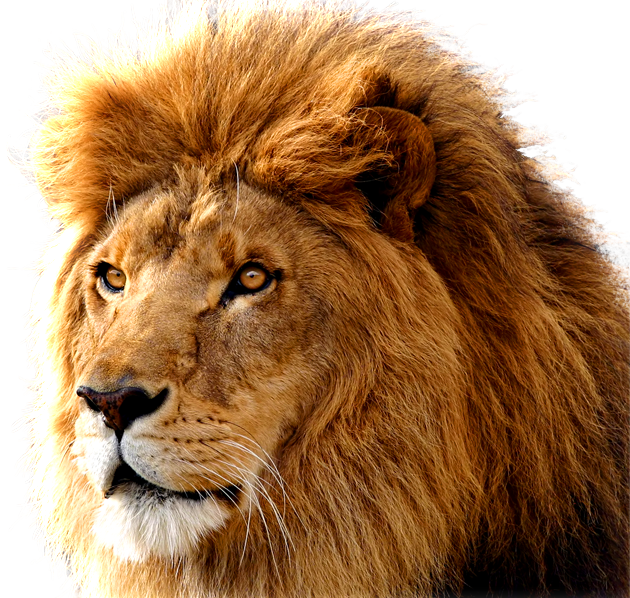

In [76]:
from IPython.display import Image
Image(filename='lion.png') 


In [77]:
Image(filename='lion_cloud.png') 
hide_code_in_slideshow()

In [78]:
#bag of words
def top_words(corpus, n=None):
    vec = CountVectorizer(stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = top_words(sd_cleanR.SDTweets, 10)
unigram = pd.DataFrame(common_words, columns = ['unigram' , 'count'])

#topic modelling
vectorizer = CountVectorizer(
analyzer='word',       
min_df=3,#minimum word occurences parameter
stop_words='english',#remove stop words
lowercase=True,#words to lowercase
token_pattern='[a-zA-Z0-9]{3,}',#num characters > 3
max_features=5000,#maximum unique words
                          )
#document term matriz
dtm = vectorizer.fit_transform(sd_cleanR.SDTweets)
dtm

lda_model = LatentDirichletAllocation(
n_components=5,#change to manipulate topic number
learning_method='online',
random_state=36, #random state       
n_jobs = -1 #for performance use all available CPUs
                                     )
lda_output = lda_model.fit_transform(dtm)

for i,topic in enumerate(lda_model.components_):
    print(f'Top 10 words for topic #{i}:')
    print([vectorizer.get_feature_names()[i] for i in topic.argsort()[-10:]]) #-10 signifies that we want 10 top words per topic
    print('\n')
    
topic_values = lda_model.transform(dtm)
sd_cleanR['Topic'] = topic_values.argmax(axis=1)
hide_code_in_slideshow()

Top 10 words for topic #0:
['death', 'new', 'number', 'year', 'county', 'flu', 'case', 'covid', 'diego', 'san']


Top 10 words for topic #1:
['year', 'covid', 'health', 'public', 'flu', 'maskssocial', 'distancing', 'wear', 'san', 'diego']


Top 10 words for topic #2:
['petition', 'convention', 'change', 'county', 'sign', 'shelter', 'center', 'homeless', 'diego', 'san']


Top 10 words for topic #3:
['demand', 'diegos', 'begin', 'set', 'plan', 'light', 'day', 'vaccine', 'diego', 'san']


Top 10 words for topic #4:
['accident', 'right', 'zone', 'work', 'close', 'ave', 'sdtraffic', 'lane', 'stop', 'traffic']




## Twitter Sentiment Analysis

In [115]:
'''Subjectivity & Polarity'''
#Function subjectivity
def getSubjectivity(text):
    return TextBlob(text).sentiment.subjectivity

#Function polarity
def getPolarity(text):
    return TextBlob(text).sentiment.polarity

#Create two new columns
sd_cleanR['Subjectivity'] = sd_cleanR['SDTweets'].apply(getSubjectivity)
sd_cleanR['Polarity'] = sd_cleanR['SDTweets'].apply(getPolarity)

'''Function to separate tweets into negative, neutral, and positive'''

def getSentiment(score):  
    
    if (score == 0):
         return('Neutral')
    elif (score > 0 and score <= 0.3):
         return('Weakly Positive')
    elif (score > 0.3 and score <= 0.6):
         return('Positive')
    elif (score > 0.6 and score <= 1):
         return('Strongly Positive')
    elif (score > -0.3 and score <= 0):
        return('Weakly Negative')
    elif (score > -0.6 and score <= -0.3):
         return('Negative')
    elif (score > -1 and score <= -0.6):
        return('Strongly Negative')

        
sd_cleanR['Sentiment'] = sd_cleanR['Polarity'].apply(getSentiment)

#words = basic_clean(''.join(str(sd_clean['SDTweets'].tolist())))

In [110]:
sd_cleanR.style

,SDTweets,Topic,Subjectivity,Polarity,Sentiment
0,ladoodles sandiegocounty yes exactly san diego hhs please please get covid under control like korea japan vietnam taiwan so the strain and loss from covid do not make thing bad on top of the meltdown of out federal government get back to the yellow tier and get biz back open,0,0.273810,0.007143,Weakly Positive
1,some million californians sign up for smartphone alert in first few day the san diego uniontribune more w ecosearch,2,0.311111,0.183333,Weakly Positive
2,san diego housing commission keep the san diego convention center homeless shelter sign the petition via change,2,0.100000,-0.100000,Weakly Negative
3,as covid vaccine distribution begin here ’s san diego county ’s phase plan,3,0.000000,0.000000,Neutral
4,san diego be not in the subduction zone but be a fault zone soon i hope to visit seattle portland and vancouver when safe to travel because covid only then can i say i fully overcome fear of cascadia sz 👏 🏻,3,0.750000,0.250000,Weakly Positive
5,california ’s attorney general have tell the owner of two san diego strip club to stop operate in violation of the state health order,3,0.500000,0.050000,Weakly Positive
6,plus why the huge surge in covid case if preventative measure and mandate be help the flu think be stupid,0,0.950000,-0.200000,Weakly Negative
7,just a bs article about how there ’ significantly less flu case in san diego this year due to increase in flu vaccination and the preventative measure people be take to fight covid if the flu shot help with covid too then the flu be covid covid be the flu,0,0.220833,-0.145833,Weakly Negative
8,this battle be not get any easy everyday be lose more nurse to covid do not have enough bed or personnel fuck covid i try to transfer a patient who need high level of care every major hospital from san diego la las vegas to san fran at capacity,0,0.581905,0.079405,Weakly Positive
9,to help keep san diego healthy and move nctd mask be available on board vehicle and at customer service center for those who need for more info on nctds response visit,0,0.375000,0.325000,Positive
